<a href="https://colab.research.google.com/github/tomorn112/ZC-DINO-ER/blob/part3/CLIPSegHen.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Set-up environment

Let's first install 🤗 Transformers. We install from source as the model is brand new at the moment of writing.

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
!pip install -q git+https://github.com/huggingface/transformers.git

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


## Load image

Next, let's load an image.

<ipython-input-3-d1ba618f0d47>:47: UserWarning: Tight layout not applied. tight_layout cannot make Axes width small enough to accommodate all Axes decorations
  plt.tight_layout()


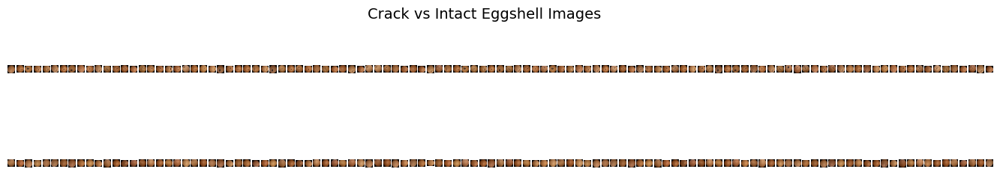

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# Define the image directory path
image_dir = "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/"

# Subfolders to look for images
subfolders = ["crack", "intact"]

# Number of images to display per class
num_images_per_class = 113

# Store loaded images
images_crack = []
images_intact = []

# Load images from subdirectories
for label in subfolders:
    path = os.path.join(image_dir, label)
    all_files = sorted(os.listdir(path))
    image_files = [f for f in all_files if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:num_images_per_class]

    for img_name in image_files:
        img_path = os.path.join(path, img_name)
        image = Image.open(img_path)
        if label == "crack":
            images_crack.append(image)
        else:
            images_intact.append(image)

# Combine and plot
num_cols = num_images_per_class
num_rows = 2  # one row for crack, one for intact

fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 0.15, 3))

for i in range(num_images_per_class):
    axes[0, i].imshow(images_crack[i])
    axes[0, i].axis("off")
    axes[1, i].imshow(images_intact[i])
    axes[1, i].axis("off")

axes[0, 0].set_ylabel("Crack", size=12)
axes[1, 0].set_ylabel("Intact", size=12)
plt.suptitle("Crack vs Intact Eggshell Images", fontsize=14)
plt.tight_layout()
plt.show()


## Load model

Next, let's load the model and its processor from the [hub](https://huggingface.co/CIDAS/clipseg-rd64-refined).

In [ ]:
from transformers import CLIPSegProcessor, CLIPSegForImageSegmentation

processor = CLIPSegProcessor.from_pretrained("CIDAS/clipseg-rd64-refined")
model = CLIPSegForImageSegmentation.from_pretrained("CIDAS/clipseg-rd64-refined")

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.
/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/380 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/974 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.73k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/603M [00:00<?, ?B/s]

In [ ]:
from transformers import CLIPSegProcessor, CLIPSegForImageSegmentation

# Load the processor and model from the pretrained weights
processor = CLIPSegProcessor.from_pretrained("CIDAS/clipseg-rd64-refined")
model = CLIPSegForImageSegmentation.from_pretrained("CIDAS/clipseg-rd64-refined")

# Calculate total number of trainable parameters
total_params = sum(p.numel() for p in model.parameters())

# Print the total parameter count
print(f"Total number of parameters in CLIPSeg model: {total_params:,}")


Total number of parameters in CLIPSeg model: 150,747,746


## Prepare image and texts for model

The image and a few prompts can be prepared for the model using the processor.

In [ ]:
prompts = ["egg", "crack"]  # prompt words = 2

# Assuming 'images' is a list of images and you want to process each image with all prompts
crack_inputs_list = []  # Fill this list with crack image inputs
intact_inputs_list = []  # Fill this list with intact image inputs

for i in range(len(images_crack)):
    inputs = processor(text=prompts, images=[images_crack[i]] * len(prompts), padding="max_length", return_tensors="pt")
    crack_inputs_list.append(inputs)

for i in range(len(images_intact)):
    inputs = processor(text=prompts, images=[images_intact[i]] * len(prompts), padding="max_length", return_tensors="pt")
    intact_inputs_list.append(inputs)


/usr/local/lib/python3.11/dist-packages/transformers/image_processing_utils.py:42: UserWarning: The following named arguments are not valid for `ViTImageProcessor.preprocess` and were ignored: 'padding'
  return self.preprocess(images, **kwargs)


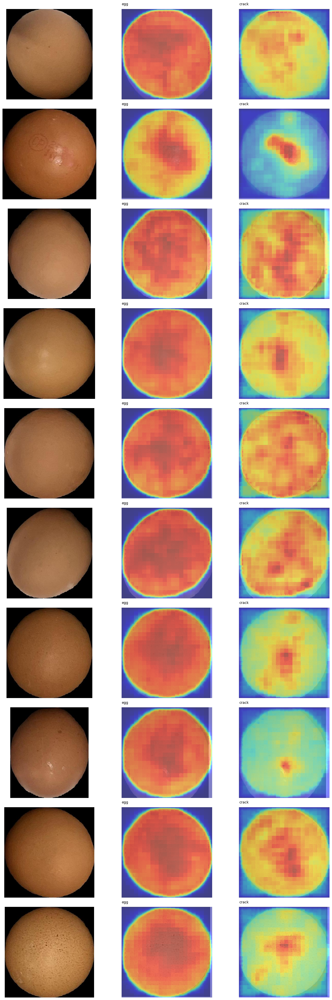

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np

# Predict for all images
preds_list = []
with torch.no_grad():
    for inputs in intact_inputs_list:
        outputs = model(**inputs)
        preds_list.append(outputs.logits.unsqueeze(1))

# Visualize predictions for a subset of images to avoid size issues
max_images = 10  # Display only up to 10 images at a time
num_images_to_display = min(len(images_intact), max_images)
_, ax = plt.subplots(num_images_to_display, len(prompts) + 1, figsize=(15, 4 * num_images_to_display))
ax = ax.flatten()

for i in range(num_images_to_display):
    ax[i * (len(prompts) + 1)].imshow(images_intact[i])
    ax[i * (len(prompts) + 1)].axis('off')
    for j in range(len(prompts)):
        pred = torch.sigmoid(preds_list[i][j][0]).cpu().numpy()
        ax[i * (len(prompts) + 1) + j + 1].imshow(images_intact[i], cmap='gray', alpha=0.5)  # Display original image in gray
        ax[i * (len(prompts) + 1) + j + 1].imshow(pred, cmap='jet', alpha=0.5)  # Overlay predictions with jet colormap
        ax[i * (len(prompts) + 1) + j + 1].axis('off')
        ax[i * (len(prompts) + 1) + j + 1].text(0, -15, prompts[j])

plt.tight_layout()
plt.show()


#Measurement Latency, Inference time, FPS, Memory usage

Inference Time: 54.3596 seconds
Frames Per Second (FPS): 2.08
CPU Usage Before: 2.40%, After: 0.60%
RAM Usage Increase: 0.1540 GB
GPU Memory Increase: 0.0000 GB
GPU Utilization Increase: 0.00%


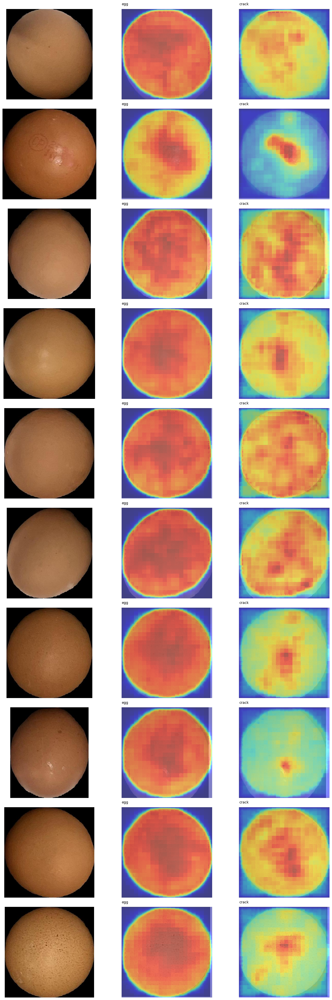

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import time
import psutil
import pynvml  # To get GPU usage from NVIDIA GPUs

# Initialize GPU tracking
use_cuda = torch.cuda.is_available()
if use_cuda:
    device = torch.device("cuda")
    torch.cuda.synchronize()
    pynvml.nvmlInit()
    handle = pynvml.nvmlDeviceGetHandleByIndex(0)  # Assuming first GPU
else:
    device = torch.device("cpu")

# Track CPU & Memory usage
cpu_usage_before = psutil.cpu_percent(interval=1)
ram_usage_before = psutil.virtual_memory().used / (1024 ** 3)  # Convert bytes to GB

# Track GPU Memory before inference (if GPU is used)
if use_cuda:
    gpu_mem_before = torch.cuda.memory_allocated(device) / (1024 ** 3)  # Convert bytes to GB
    gpu_util_before = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu  # GPU utilization before inference

# Start timing
start_time = time.time()

# Predict for all images
preds_list = []
with torch.no_grad():
    for inputs in intact_inputs_list:
        outputs = model(**inputs)
        preds_list.append(outputs.logits.unsqueeze(1))

# End timing
end_time = time.time()

# Calculate latency and FPS
inference_time = end_time - start_time  # Total time taken
num_images = len(intact_inputs_list)
fps = num_images / inference_time if inference_time > 0 else float('inf')

# Track CPU & Memory usage after inference
cpu_usage_after = psutil.cpu_percent(interval=1)
ram_usage_after = psutil.virtual_memory().used / (1024 ** 3)  # Convert bytes to GB
ram_usage_diff = ram_usage_after - ram_usage_before

# Track GPU Memory after inference (if GPU is used)
if use_cuda:
    gpu_mem_after = torch.cuda.memory_allocated(device) / (1024 ** 3)  # Convert bytes to GB
    gpu_util_after = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu  # GPU utilization after inference
    gpu_mem_diff = gpu_mem_after - gpu_mem_before
    gpu_util_diff = gpu_util_after - gpu_util_before
else:
    gpu_mem_diff = 0
    gpu_util_diff = 0

# Print Performance Metrics
print(f"Inference Time: {inference_time:.4f} seconds")
print(f"Frames Per Second (FPS): {fps:.2f}")
print(f"CPU Usage Before: {cpu_usage_before:.2f}%, After: {cpu_usage_after:.2f}%")
print(f"RAM Usage Increase: {ram_usage_diff:.4f} GB")
print(f"GPU Memory Increase: {gpu_mem_diff:.4f} GB")
print(f"GPU Utilization Increase: {gpu_util_diff:.2f}%")

# ------------------ Visualization ------------------

# Visualize predictions for a subset of images
max_images = 10  # Display only up to 10 images at a time
num_images_to_display = min(len(images_intact), max_images)
_, ax = plt.subplots(num_images_to_display, len(prompts) + 1, figsize=(15, 4 * num_images_to_display))
ax = ax.flatten()

for i in range(num_images_to_display):
    ax[i * (len(prompts) + 1)].imshow(images_intact[i])
    ax[i * (len(prompts) + 1)].axis('off')
    for j in range(len(prompts)):
        pred = torch.sigmoid(preds_list[i][j][0]).cpu().numpy()
        ax[i * (len(prompts) + 1) + j + 1].imshow(images_intact[i], cmap='gray', alpha=0.5)  # Display original image in gray
        ax[i * (len(prompts) + 1) + j + 1].imshow(pred, cmap='jet', alpha=0.5)  # Overlay predictions with jet colormap
        ax[i * (len(prompts) + 1) + j + 1].axis('off')
        ax[i * (len(prompts) + 1) + j + 1].text(0, -15, prompts[j])

plt.tight_layout()
plt.show()

# Cleanup GPU tracking
if use_cuda:
    pynvml.nvmlShutdown()


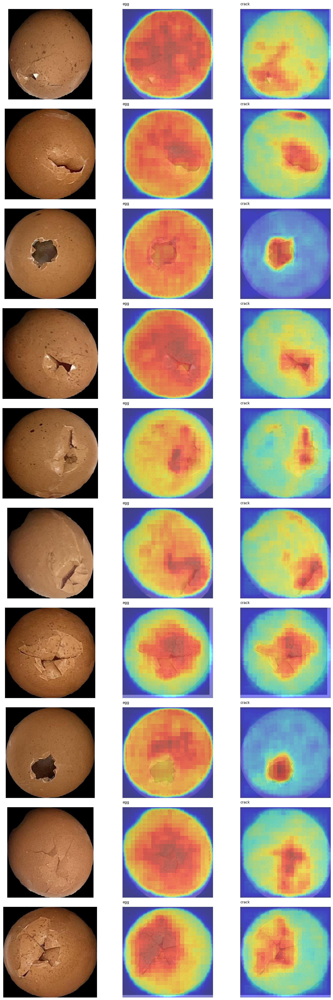

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np

# Predict for all images
preds_list = []
with torch.no_grad():
    for inputs in crack_inputs_list:
        outputs = model(**inputs)
        preds_list.append(outputs.logits.unsqueeze(1))

# Visualize predictions for a subset of images to avoid size issues
max_images = 10  # Display only up to 10 images at a time
num_images_to_display = min(len(images_crack), max_images)
_, ax = plt.subplots(num_images_to_display, len(prompts) + 1, figsize=(15, 4 * num_images_to_display))
ax = ax.flatten()

for i in range(num_images_to_display):
    ax[i * (len(prompts) + 1)].imshow(images_crack[i])
    ax[i * (len(prompts) + 1)].axis('off')
    for j in range(len(prompts)):
        pred = torch.sigmoid(preds_list[i][j][0]).cpu().numpy()
        ax[i * (len(prompts) + 1) + j + 1].imshow(images_crack[i], cmap='gray', alpha=0.5)  # Display original image in gray
        ax[i * (len(prompts) + 1) + j + 1].imshow(pred, cmap='jet', alpha=0.5)  # Overlay predictions with jet colormap
        ax[i * (len(prompts) + 1) + j + 1].axis('off')
        ax[i * (len(prompts) + 1) + j + 1].text(0, -15, prompts[j])

plt.tight_layout()
plt.show()


## Forward pass

Next, let's run a forward pass and visualize the predictions the model made.

As can be seen, the model is capable of segmenting images based on text prompts in a zero-shot manner. Pretty cool, huh?

## Convert to binary mask

To convert to a binary mask, I borrow some logic from [here](https://github.com/amrrs/stable-diffusion-prompt-inpainting). One can apply a sigmoid activation function on the predicted mask and use some OpenCV (cv2) to turn it into a binary mask.

# Binary masks intact

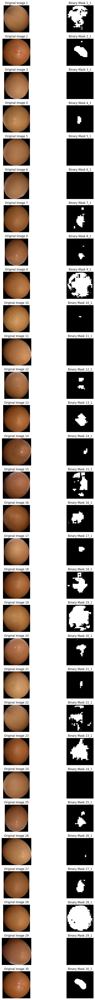

In [ ]:
import torch
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import numpy as np
import os

# Function to create directories if they don't exist
def create_directory(dir_name):
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)

# Create directories for crack and intact masks

create_directory('intact_masks')

# Assuming you have separate input lists for crack and intact images
#crack_inputs_list = [...]  # Fill this list with crack image inputs
#intact_inputs_list = [...]  # Fill this list with intact image inputs

# Combine both lists for processing
inputs_list = intact_inputs_list
#prompts = [...]  # List of prompts used

# Placeholder for original images
original_images = images_intact# List of original images corresponding to the inputs

# Function to process inputs, save binary masks, and return them for display
def process_and_save_masks(inputs_list, original_images, save_dir):
    preds_list = []
    binary_masks = []
    with torch.no_grad():
        for inputs in inputs_list:
            outputs = model(**inputs)
            preds_list.append(outputs.logits.unsqueeze(1))

    for i in range(len(inputs_list)):
        for j in range(len(prompts)):
            if j == 1:  # Only save the mask named {i}_1
                # Get the predicted mask and apply sigmoid activation
                mask = torch.sigmoid(preds_list[i][j][0]).cpu().numpy()

                # Scale mask to 0-255
                mask = (mask * 255).astype(np.uint8)

                # Apply binary threshold
                _, binary_mask = cv2.threshold(mask, 50, 255, cv2.THRESH_BINARY)

                # Save the binary mask
                filename = os.path.join(save_dir, f"binary_mask_intact_{i}_1.png")
                plt.imsave(filename, binary_mask, cmap='gray')

                # Append the binary mask for display
                binary_masks.append(binary_mask)

    return binary_masks

# Process and save masks for intact images and get the binary masks
binary_masks = process_and_save_masks(inputs_list, original_images, 'intact_masks')

# Display the first 10 original images and their corresponding masks
num_images_to_display = 30
fig, axes = plt.subplots(num_images_to_display, 2, figsize=(10, 2 * num_images_to_display))
for i in range(num_images_to_display):
    # Display original image
    axes[i, 0].imshow(original_images[i])
    axes[i, 0].axis('off')
    axes[i, 0].set_title(f"Original Image {i+1}")

    # Display binary mask
    axes[i, 1].imshow(binary_masks[i], cmap='gray')
    axes[i, 1].axis('off')
    axes[i, 1].set_title(f"Binary Mask {i+1}_1")

plt.tight_layout()
plt.show()


--- Performance Metrics ---
Inference Time: 59.6427 seconds
Frames Per Second (FPS): 1.89
CPU Usage Before: 1.50%, After: 0.30%
RAM Usage Increase: -0.0386 GB
GPU Memory Increase: 0.0000 GB
GPU Utilization Increase: 0.00%



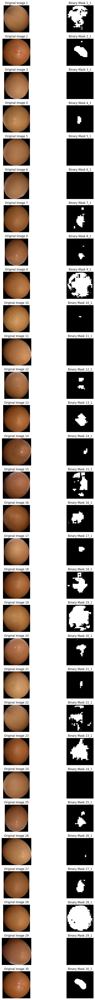

In [ ]:
import torch
import matplotlib.pyplot as plt
import cv2
import psutil
import time
import numpy as np
import os
import pynvml  # NVIDIA GPU tracking
from PIL import Image

# Function to create directories if they don't exist
def create_directory(dir_name):
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)

# Create output directory
create_directory('intact_masks')

# Initialize GPU tracking
use_cuda = torch.cuda.is_available()
if use_cuda:
    device = torch.device("cuda")
    torch.cuda.synchronize()
    pynvml.nvmlInit()
    handle = pynvml.nvmlDeviceGetHandleByIndex(0)  # Assuming first GPU
else:
    device = torch.device("cpu")

# Track CPU & Memory usage before processing
cpu_usage_before = psutil.cpu_percent(interval=1)
ram_usage_before = psutil.virtual_memory().used / (1024 ** 3)  # Convert bytes to GB

# Track GPU Memory before inference (if GPU is used)
if use_cuda:
    gpu_mem_before = torch.cuda.memory_allocated(device) / (1024 ** 3)  # Convert bytes to GB
    gpu_util_before = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu  # GPU utilization before inference

# Start timing
start_time = time.time()

# Function to process inputs, save binary masks, and return them for display
def process_and_save_masks(inputs_list, original_images, save_dir):
    preds_list = []
    binary_masks = []

    with torch.no_grad():
        for inputs in inputs_list:
            outputs = model(**inputs)
            preds_list.append(outputs.logits.unsqueeze(1))

    for i in range(len(inputs_list)):
        for j in range(len(prompts)):
            if j == 1:  # Only save the mask named {i}_1
                # Get the predicted mask and apply sigmoid activation
                mask = torch.sigmoid(preds_list[i][j][0]).cpu().numpy()

                # Scale mask to 0-255
                mask = (mask * 255).astype(np.uint8)

                # Apply binary threshold
                _, binary_mask = cv2.threshold(mask, 50, 255, cv2.THRESH_BINARY)

                # Save the binary mask
                filename = os.path.join(save_dir, f"binary_mask_intact_{i}_1.png")
                plt.imsave(filename, binary_mask, cmap='gray')

                # Append the binary mask for display
                binary_masks.append(binary_mask)

    return binary_masks

# Process and save masks for intact images and get the binary masks
binary_masks = process_and_save_masks(inputs_list, images_intact, 'intact_masks')

# End timing
end_time = time.time()

# Calculate latency and FPS
inference_time = end_time - start_time  # Total time taken
num_images = len(inputs_list)
fps = num_images / inference_time if inference_time > 0 else float('inf')

# Track CPU & Memory usage after inference
cpu_usage_after = psutil.cpu_percent(interval=1)
ram_usage_after = psutil.virtual_memory().used / (1024 ** 3)  # Convert bytes to GB
ram_usage_diff = ram_usage_after - ram_usage_before

# Track GPU Memory after inference (if GPU is used)
if use_cuda:
    gpu_mem_after = torch.cuda.memory_allocated(device) / (1024 ** 3)  # Convert bytes to GB
    gpu_util_after = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu  # GPU utilization after inference
    gpu_mem_diff = gpu_mem_after - gpu_mem_before
    gpu_util_diff = gpu_util_after - gpu_util_before
else:
    gpu_mem_diff = 0
    gpu_util_diff = 0

# Print Performance Metrics
print(f"\n--- Performance Metrics ---")
print(f"Inference Time: {inference_time:.4f} seconds")
print(f"Frames Per Second (FPS): {fps:.2f}")
print(f"CPU Usage Before: {cpu_usage_before:.2f}%, After: {cpu_usage_after:.2f}%")
print(f"RAM Usage Increase: {ram_usage_diff:.4f} GB")
print(f"GPU Memory Increase: {gpu_mem_diff:.4f} GB")
print(f"GPU Utilization Increase: {gpu_util_diff:.2f}%\n")

# ------------------ Visualization ------------------
num_images_to_display = 30
fig, axes = plt.subplots(num_images_to_display, 2, figsize=(10, 2 * num_images_to_display))

for i in range(num_images_to_display):
    # Display original image
    axes[i, 0].imshow(images_intact[i])
    axes[i, 0].axis('off')
    axes[i, 0].set_title(f"Original Image {i+1}")

    # Display binary mask
    axes[i, 1].imshow(binary_masks[i], cmap='gray')
    axes[i, 1].axis('off')
    axes[i, 1].set_title(f"Binary Mask {i+1}_1")

plt.tight_layout()
plt.show()

# Cleanup GPU tracking
if use_cuda:
    pynvml.nvmlShutdown()


# Binary masks crack

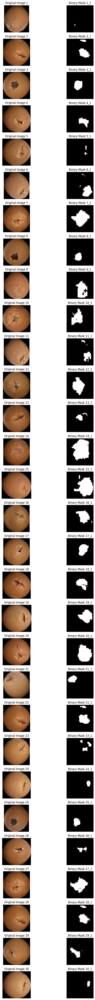

In [ ]:
import torch
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import numpy as np
import os

# Function to create directories if they don't exist
def create_directory(dir_name):
    if not os.path.exists(dir_name):
        os.makedirs(dir_name)

# Create directories for crack and intact masks

create_directory('crack_masks')

# Assuming you have separate input lists for crack and intact images
#crack_inputs_list = [...]  # Fill this list with crack image inputs
#intact_inputs_list = [...]  # Fill this list with intact image inputs

# Combine both lists for processing
inputs_list = crack_inputs_list
#prompts = [...]  # List of prompts used

# Placeholder for original images
original_images = images_crack# List of original images corresponding to the inputs

# Function to process inputs, save binary masks, and return them for display
def process_and_save_masks(inputs_list, original_images, save_dir):
    preds_list = []
    binary_masks = []
    with torch.no_grad():
        for inputs in inputs_list:
            outputs = model(**inputs)
            preds_list.append(outputs.logits.unsqueeze(1))

    for i in range(len(inputs_list)):
        for j in range(len(prompts)):
            if j == 1:  # Only save the mask named {i}_1
                # Get the predicted mask and apply sigmoid activation
                mask = torch.sigmoid(preds_list[i][j][0]).cpu().numpy()

                # Scale mask to 0-255
                mask = (mask * 255).astype(np.uint8)

                # Apply binary threshold
                _, binary_mask = cv2.threshold(mask, 50, 255, cv2.THRESH_BINARY)

                # Save the binary mask
                filename = os.path.join(save_dir, f"binary_mask_crack_{i}_1.png")
                plt.imsave(filename, binary_mask, cmap='gray')

                # Append the binary mask for display
                binary_masks.append(binary_mask)

    return binary_masks

# Process and save masks for intact images and get the binary masks
binary_masks = process_and_save_masks(inputs_list, original_images, 'crack_masks')

# Display the first 10 original images and their corresponding masks
num_images_to_display = 30
fig, axes = plt.subplots(num_images_to_display, 2, figsize=(10, 2 * num_images_to_display))
for i in range(num_images_to_display):
    # Display original image
    axes[i, 0].imshow(original_images[i])
    axes[i, 0].axis('off')
    axes[i, 0].set_title(f"Original Image {i+1}")

    # Display binary mask
    axes[i, 1].imshow(binary_masks[i], cmap='gray')
    axes[i, 1].axis('off')
    axes[i, 1].set_title(f"Binary Mask {i+1}_1")

plt.tight_layout()
plt.show()

Image files:
['/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_0.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_0_21.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_0_23.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_0_26.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_0_27.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_0_28.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_0_29.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_10_21.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_10_24.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_10_26.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/maskegg_10_27.jpg', '/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/cr

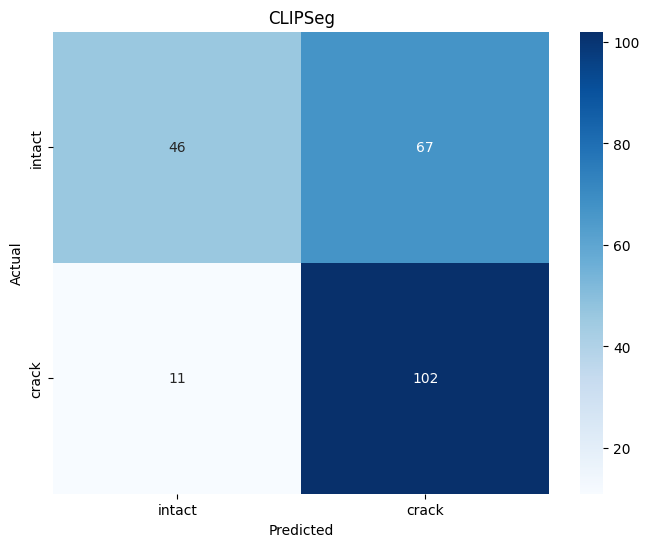

In [ ]:
import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# Calculate saliency score based on white pixels in the binary mask
def calculate_saliency_score(binary_mask, original_image):
    if not isinstance(binary_mask, np.ndarray):
        binary_mask = np.array(binary_mask)
    if not isinstance(original_image, np.ndarray):
        original_image = np.array(original_image)

    # Assuming the eggshell is represented by non-background pixels (not black)
    eggshell_pixels = np.sum(original_image != 0)  # Adjust based on background color

    # Count white pixels in the binary mask
    white_pixel_count = np.sum(binary_mask == 255)

    # Calculate saliency score
    saliency_score = white_pixel_count / eggshell_pixels if eggshell_pixels != 0 else 0
    return saliency_score

# Function to get ground truth labels based on folder names
def get_ground_truth_labels(image_paths):
    labels = []
    for path in image_paths:
        if 'crack' in path.lower():
            labels.append('crack')
        else:
            labels.append('intact')
    return labels

# Define paths and constants *************************************************************************************************************score
threshold = 0.03  # Saliency score threshold
image_dir_crack = "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack"
image_dir_intact = "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/intact"  # Adjust to your image directory
binary_mask_dir_crack = '/content/crack_masks'  # Adjust to your binary masks directory
binary_mask_dir_intact = '/content/intact_masks'  # Adjust to your binary masks directory

# List and verify image files
image_files_crack = sorted([os.path.join(image_dir_crack, f) for f in os.listdir(image_dir_crack) if os.path.isfile(os.path.join(image_dir_crack, f))])
image_files_intact = sorted([os.path.join(image_dir_intact, f) for f in os.listdir(image_dir_intact) if os.path.isfile(os.path.join(image_dir_intact, f))])
image_files = image_files_crack + image_files_intact

if len(image_files) == 0:
    raise ValueError("No image files found in the specified image directories.")
if not (os.path.exists(binary_mask_dir_crack) and os.path.exists(binary_mask_dir_intact)):
    raise ValueError(f"Binary mask directories do not exist.")

# List and verify binary mask files
binary_mask_files_crack = sorted([os.path.join(binary_mask_dir_crack, f) for f in os.listdir(binary_mask_dir_crack) if os.path.isfile(os.path.join(binary_mask_dir_crack, f))])
binary_mask_files_intact = sorted([os.path.join(binary_mask_dir_intact, f) for f in os.listdir(binary_mask_dir_intact) if os.path.isfile(os.path.join(binary_mask_dir_intact, f))])
binary_mask_files = binary_mask_files_crack + binary_mask_files_intact

if len(binary_mask_files) == 0:
    raise ValueError("No binary mask files found in the specified binary mask directories.")

# Create a dictionary to map image files to their corresponding binary mask files
image_to_mask_mapping = {os.path.basename(image_file): mask_file for image_file, mask_file in zip(image_files, binary_mask_files)}

# Print files for debugging
print("Image files:")
print(image_files)
print("\nBinary mask files:")
print(binary_mask_files)

# Load ground truth labels
ground_truth_labels = get_ground_truth_labels(image_files)

predicted_labels = []

# Predict for all images
for image_file in image_files:
    # Load the original image
    original_image = cv2.imread(image_file, cv2.IMREAD_GRAYSCALE)
    if original_image is None:
        print(f"Error reading image {image_file}")
        continue

    # Find the corresponding binary mask file
    image_basename = os.path.basename(image_file)
    binary_mask_file = image_to_mask_mapping.get(image_basename)
    if binary_mask_file is None:
        print(f"No binary mask found for image {image_file}")
        continue

    binary_mask = cv2.imread(binary_mask_file, cv2.IMREAD_GRAYSCALE)
    if binary_mask is None:
        print(f"Error reading binary mask {binary_mask_file}")
        continue

    # Calculate the saliency score
    saliency_score = calculate_saliency_score(binary_mask, original_image)

    # Classify based on the threshold
    if saliency_score > threshold:
        predicted_labels.append('crack')
    else:
        predicted_labels.append('intact')

# Calculate metrics
accuracy = accuracy_score(ground_truth_labels, predicted_labels)
precision = precision_score(ground_truth_labels, predicted_labels, pos_label='crack', zero_division=1)
recall = recall_score(ground_truth_labels, predicted_labels, pos_label='crack', zero_division=1)
f1 = f1_score(ground_truth_labels, predicted_labels, pos_label='crack', zero_division=1)
conf_matrix = confusion_matrix(ground_truth_labels, predicted_labels, labels=['intact', 'crack'])

# Display results
print(f'Accuracy: {accuracy}')
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1 Score: {f1}')

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['intact', 'crack'], yticklabels=['intact', 'crack'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('CLIPSeg')
plt.show()



--- Performance Metrics ---
Inference Time: 1.3490 seconds
Frames Per Second (FPS): 167.54
CPU Usage Before: 9.30%, After: 0.50%
RAM Usage Increase: 0.0032 GB
GPU Memory Increase: 0.0000 GB
GPU Utilization Increase: 0.00%


--- Model Evaluation ---
Accuracy: 0.6549
Precision: 0.6036
Recall: 0.9027
F1 Score: 0.7234


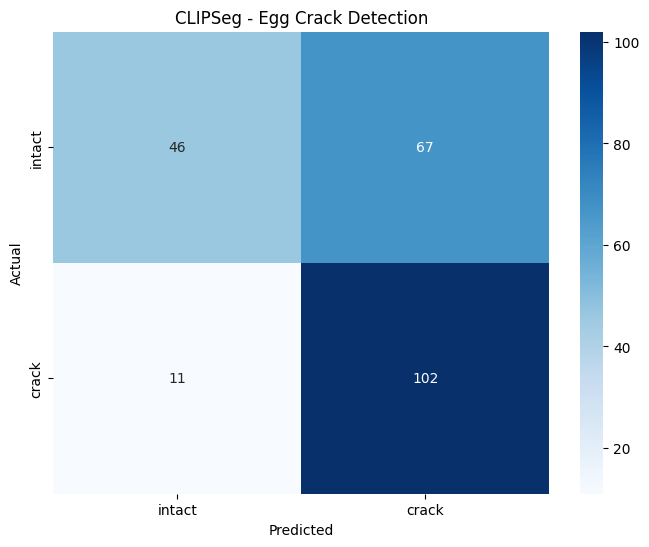

In [ ]:
import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import time
import psutil
import pynvml  # NVIDIA GPU tracking
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# Initialize GPU tracking
use_cuda = torch.cuda.is_available()
if use_cuda:
    device = torch.device("cuda")
    torch.cuda.synchronize()
    pynvml.nvmlInit()
    handle = pynvml.nvmlDeviceGetHandleByIndex(0)  # Assuming first GPU
else:
    device = torch.device("cpu")

# Function to calculate saliency score based on white pixels in the binary mask
def calculate_saliency_score(binary_mask, original_image):
    if not isinstance(binary_mask, np.ndarray):
        binary_mask = np.array(binary_mask)
    if not isinstance(original_image, np.ndarray):
        original_image = np.array(original_image)

    # Assuming the eggshell is represented by non-background pixels (not black)
    eggshell_pixels = np.sum(original_image != 0)

    # Count white pixels in the binary mask
    white_pixel_count = np.sum(binary_mask == 255)

    # Calculate saliency score
    saliency_score = white_pixel_count / eggshell_pixels if eggshell_pixels != 0 else 0
    return saliency_score

# Function to get ground truth labels based on folder names
def get_ground_truth_labels(image_paths):
    return ['crack' if 'crack' in path.lower() else 'intact' for path in image_paths]

# Define paths and constants
threshold = 0.03  # Saliency score threshold
image_dir_crack = "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack"
image_dir_intact = "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/intact"
binary_mask_dir_crack = '/content/crack_masks'
binary_mask_dir_intact = '/content/intact_masks'


# List and verify image files
image_files_crack = sorted([os.path.join(image_dir_crack, f) for f in os.listdir(image_dir_crack) if os.path.isfile(os.path.join(image_dir_crack, f))])
image_files_intact = sorted([os.path.join(image_dir_intact, f) for f in os.listdir(image_dir_intact) if os.path.isfile(os.path.join(image_dir_intact, f))])
image_files = image_files_crack + image_files_intact

if len(image_files) == 0:
    raise ValueError("No image files found in the specified image directories.")
if not (os.path.exists(binary_mask_dir_crack) and os.path.exists(binary_mask_dir_intact)):
    raise ValueError("Binary mask directories do not exist.")

# List and verify binary mask files
binary_mask_files_crack = sorted([os.path.join(binary_mask_dir_crack, f) for f in os.listdir(binary_mask_dir_crack) if os.path.isfile(os.path.join(binary_mask_dir_crack, f))])
binary_mask_files_intact = sorted([os.path.join(binary_mask_dir_intact, f) for f in os.listdir(binary_mask_dir_intact) if os.path.isfile(os.path.join(binary_mask_dir_intact, f))])
binary_mask_files = binary_mask_files_crack + binary_mask_files_intact

if len(binary_mask_files) == 0:
    raise ValueError("No binary mask files found in the specified binary mask directories.")

# Create a dictionary to map image files to their corresponding binary mask files
image_to_mask_mapping = {os.path.basename(image_file): mask_file for image_file, mask_file in zip(image_files, binary_mask_files)}

# Load ground truth labels
ground_truth_labels = get_ground_truth_labels(image_files)

# Performance Tracking: Start
cpu_usage_before = psutil.cpu_percent(interval=1)
ram_usage_before = psutil.virtual_memory().used / (1024 ** 3)  # Convert bytes to GB

if use_cuda:
    gpu_mem_before = torch.cuda.memory_allocated(device) / (1024 ** 3)
    gpu_util_before = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu
else:
    gpu_mem_before, gpu_util_before = 0, 0

# Start Timing
start_time = time.time()

# Predict for all images
predicted_labels = []
for image_file in image_files:
    # Load the original image
    original_image = cv2.imread(image_file, cv2.IMREAD_GRAYSCALE)
    if original_image is None:
        print(f"Error reading image {image_file}")
        continue

    # Find the corresponding binary mask file
    image_basename = os.path.basename(image_file)
    binary_mask_file = image_to_mask_mapping.get(image_basename)
    if binary_mask_file is None:
        print(f"No binary mask found for image {image_file}")
        continue

    binary_mask = cv2.imread(binary_mask_file, cv2.IMREAD_GRAYSCALE)
    if binary_mask is None:
        print(f"Error reading binary mask {binary_mask_file}")
        continue

    # Calculate the saliency score
    saliency_score = calculate_saliency_score(binary_mask, original_image)

    # Classify based on the threshold
    predicted_labels.append('crack' if saliency_score > threshold else 'intact')

# End Timing
end_time = time.time()
inference_time = end_time - start_time  # Total time taken
fps = len(image_files) / inference_time if inference_time > 0 else float('inf')

# Performance Tracking: End
cpu_usage_after = psutil.cpu_percent(interval=1)
ram_usage_after = psutil.virtual_memory().used / (1024 ** 3)
ram_usage_diff = ram_usage_after - ram_usage_before

if use_cuda:
    gpu_mem_after = torch.cuda.memory_allocated(device) / (1024 ** 3)
    gpu_util_after = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu
    gpu_mem_diff = gpu_mem_after - gpu_mem_before
    gpu_util_diff = gpu_util_after - gpu_util_before
else:
    gpu_mem_diff, gpu_util_diff = 0, 0

# Calculate performance metrics
accuracy = accuracy_score(ground_truth_labels, predicted_labels)
precision = precision_score(ground_truth_labels, predicted_labels, pos_label='crack', zero_division=1)
recall = recall_score(ground_truth_labels, predicted_labels, pos_label='crack', zero_division=1)
f1 = f1_score(ground_truth_labels, predicted_labels, pos_label='crack', zero_division=1)
conf_matrix = confusion_matrix(ground_truth_labels, predicted_labels, labels=['intact', 'crack'])

# Print Performance Metrics
print("\n--- Performance Metrics ---")
print(f"Inference Time: {inference_time:.4f} seconds")
print(f"Frames Per Second (FPS): {fps:.2f}")
print(f"CPU Usage Before: {cpu_usage_before:.2f}%, After: {cpu_usage_after:.2f}%")
print(f"RAM Usage Increase: {ram_usage_diff:.4f} GB")
print(f"GPU Memory Increase: {gpu_mem_diff:.4f} GB")
print(f"GPU Utilization Increase: {gpu_util_diff:.2f}%\n")

# Print Model Evaluation Metrics
print("\n--- Model Evaluation ---")
print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['intact', 'crack'], yticklabels=['intact', 'crack'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('CLIPSeg - Egg Crack Detection')
plt.show()

# Cleanup GPU tracking
if use_cuda:
    pynvml.nvmlShutdown()


## Latency = 0.48288+0.490839823+0.005476548 = 0.979196371, **FPS = 1.0212**




--- Performance Metrics ---
Inference Time: 1.2682 seconds
Frames Per Second (FPS): 178.21
CPU Usage Before: 0.50%, After: 0.30%
RAM Usage Increase: 0.0027 GB
GPU Memory Increase: 0.0000 GB
GPU Utilization Increase: 0.00%

--- Model Evaluation ---
Accuracy:  0.6549
Precision: 0.6036
Recall:    0.9027
F1 Score:  0.7234
AUC-ROC:   0.5869


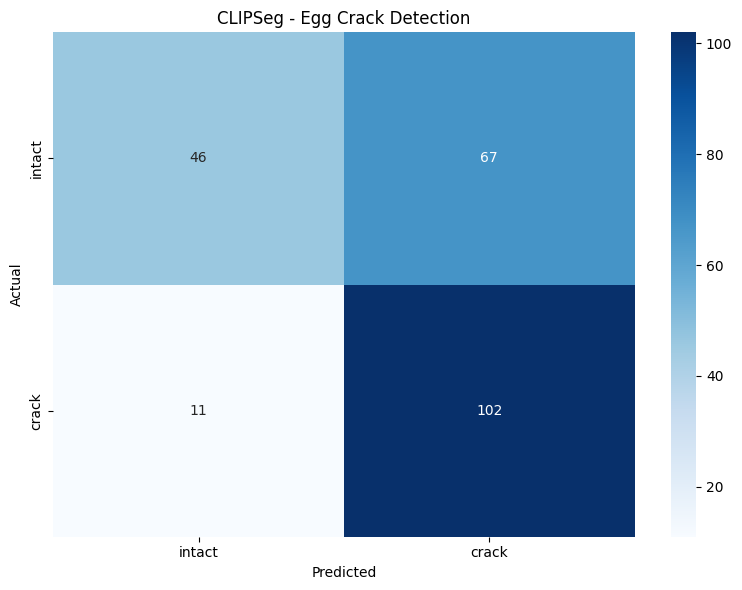

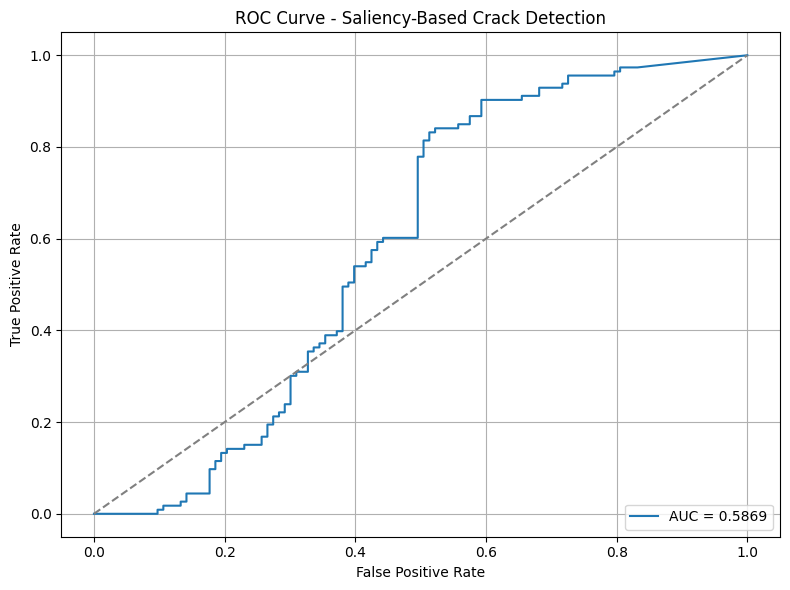

In [ ]:
import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import time
import psutil
import pynvml  # NVIDIA GPU tracking
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    confusion_matrix, roc_auc_score, roc_curve
)

# Initialize GPU tracking
use_cuda = torch.cuda.is_available()
if use_cuda:
    device = torch.device("cuda")
    torch.cuda.synchronize()
    pynvml.nvmlInit()
    handle = pynvml.nvmlDeviceGetHandleByIndex(0)
else:
    device = torch.device("cpu")

# Function to calculate saliency score
def calculate_saliency_score(binary_mask, original_image):
    if not isinstance(binary_mask, np.ndarray):
        binary_mask = np.array(binary_mask)
    if not isinstance(original_image, np.ndarray):
        original_image = np.array(original_image)
    eggshell_pixels = np.sum(original_image != 0)
    white_pixel_count = np.sum(binary_mask == 255)
    return white_pixel_count / eggshell_pixels if eggshell_pixels != 0 else 0

# Get labels from filenames
def get_ground_truth_labels(image_paths):
    return ['crack' if 'crack' in path.lower() else 'intact' for path in image_paths]

# Paths
threshold = 0.03
image_dir_crack = "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack"
image_dir_intact = "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/intact"
binary_mask_dir_crack = "/content/crack_masks"
binary_mask_dir_intact = "/content/intact_masks"

# Load image files
image_files_crack = sorted([os.path.join(image_dir_crack, f) for f in os.listdir(image_dir_crack) if os.path.isfile(os.path.join(image_dir_crack, f))])
image_files_intact = sorted([os.path.join(image_dir_intact, f) for f in os.listdir(image_dir_intact) if os.path.isfile(os.path.join(image_dir_intact, f))])
image_files = image_files_crack + image_files_intact

if not image_files:
    raise ValueError("No image files found.")
if not (os.path.exists(binary_mask_dir_crack) and os.path.exists(binary_mask_dir_intact)):
    raise ValueError("Binary mask directories do not exist.")

# Load binary mask files
binary_mask_files_crack = sorted([os.path.join(binary_mask_dir_crack, f) for f in os.listdir(binary_mask_dir_crack) if os.path.isfile(os.path.join(binary_mask_dir_crack, f))])
binary_mask_files_intact = sorted([os.path.join(binary_mask_dir_intact, f) for f in os.listdir(binary_mask_dir_intact) if os.path.isfile(os.path.join(binary_mask_dir_intact, f))])
binary_mask_files = binary_mask_files_crack + binary_mask_files_intact

if not binary_mask_files:
    raise ValueError("No binary mask files found.")

# Map images to corresponding masks
image_to_mask_mapping = {os.path.basename(image_file): mask_file for image_file, mask_file in zip(image_files, binary_mask_files)}

# Ground truth
ground_truth_labels = get_ground_truth_labels(image_files)

# Start performance tracking
cpu_usage_before = psutil.cpu_percent(interval=1)
ram_usage_before = psutil.virtual_memory().used / (1024 ** 3)

if use_cuda:
    gpu_mem_before = torch.cuda.memory_allocated(device) / (1024 ** 3)
    gpu_util_before = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu
else:
    gpu_mem_before, gpu_util_before = 0, 0

start_time = time.time()

# Predict
predicted_labels = []
predicted_scores = []

for image_file in image_files:
    original_image = cv2.imread(image_file, cv2.IMREAD_GRAYSCALE)
    if original_image is None:
        print(f"Error reading image {image_file}")
        continue

    image_basename = os.path.basename(image_file)
    binary_mask_file = image_to_mask_mapping.get(image_basename)
    if not binary_mask_file:
        print(f"No binary mask found for image {image_file}")
        continue

    binary_mask = cv2.imread(binary_mask_file, cv2.IMREAD_GRAYSCALE)
    if binary_mask is None:
        print(f"Error reading binary mask {binary_mask_file}")
        continue

    saliency_score = calculate_saliency_score(binary_mask, original_image)
    predicted_scores.append(saliency_score)
    predicted_labels.append('crack' if saliency_score > threshold else 'intact')

end_time = time.time()
inference_time = end_time - start_time
fps = len(image_files) / inference_time if inference_time > 0 else float('inf')

# End performance tracking
cpu_usage_after = psutil.cpu_percent(interval=1)
ram_usage_after = psutil.virtual_memory().used / (1024 ** 3)
ram_usage_diff = ram_usage_after - ram_usage_before

if use_cuda:
    gpu_mem_after = torch.cuda.memory_allocated(device) / (1024 ** 3)
    gpu_util_after = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu
    gpu_mem_diff = gpu_mem_after - gpu_mem_before
    gpu_util_diff = gpu_util_after - gpu_util_before
else:
    gpu_mem_diff, gpu_util_diff = 0, 0

# Metrics
accuracy = accuracy_score(ground_truth_labels, predicted_labels)
precision = precision_score(ground_truth_labels, predicted_labels, pos_label='crack', zero_division=1)
recall = recall_score(ground_truth_labels, predicted_labels, pos_label='crack', zero_division=1)
f1 = f1_score(ground_truth_labels, predicted_labels, pos_label='crack', zero_division=1)
conf_matrix = confusion_matrix(ground_truth_labels, predicted_labels, labels=['intact', 'crack'])

# Binary labels for ROC
y_true_binary = [1 if label == 'crack' else 0 for label in ground_truth_labels]
auc_score = roc_auc_score(y_true_binary, predicted_scores)
fpr, tpr, _ = roc_curve(y_true_binary, predicted_scores)

# Print performance info
print("\n--- Performance Metrics ---")
print(f"Inference Time: {inference_time:.4f} seconds")
print(f"Frames Per Second (FPS): {fps:.2f}")
print(f"CPU Usage Before: {cpu_usage_before:.2f}%, After: {cpu_usage_after:.2f}%")
print(f"RAM Usage Increase: {ram_usage_diff:.4f} GB")
print(f"GPU Memory Increase: {gpu_mem_diff:.4f} GB")
print(f"GPU Utilization Increase: {gpu_util_diff:.2f}%")

print("\n--- Model Evaluation ---")
print(f'Accuracy:  {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall:    {recall:.4f}')
print(f'F1 Score:  {f1:.4f}')
print(f'AUC-ROC:   {auc_score:.4f}')

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=['intact', 'crack'], yticklabels=['intact', 'crack'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('CLIPSeg - Egg Crack Detection')
plt.tight_layout()
plt.show()

# Plot ROC Curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f"AUC = {auc_score:.4f}")
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Saliency-Based Crack Detection')
plt.legend(loc='lower right')
plt.grid(True)
plt.tight_layout()
plt.show()

# Cleanup GPU tracking
if use_cuda:
    pynvml.nvmlShutdown()
